# Capstone Project
This notebook will explore the housing market in the GTA

In [1]:
import geopandas as gpd
import folium as f

In [2]:
# Neighbourhood and Ward shapefiles used to complement eachother in the cloropleth map when one or the other is unavailable. 
# No shapefile data was available for Halton Hills and Milton.

# Use Toronto Neighbourhood data (https://open.toronto.ca/dataset/neighbourhoods/)
# Use York Neighbourhood data (https://insights-york.opendata.arcgis.com/datasets/early-development-instrument-edi-neighbourhood-boundary)
# Use Durham Neighbourhood data (https://opendata.durham.ca/datasets/health-neighbourhoods?geometry=-80.986%2C43.775%2C-76.814%2C44.465)
# Use Oakville Ward data (https://portal-exploreoakville.opendata.arcgis.com/datasets/2018-ward-boundaries?geometry=-80.240%2C43.363%2C-79.197%2C43.537)
# Use Burlington Ward data (https://navburl-burlington.opendata.arcgis.com/datasets/ward-boundaries?geometry=-80.885%2C43.206%2C-78.799%2C43.556)
# Use Peel Ward data (https://data.peelregion.ca/datasets/wardboundary-20182022?geometry=-80.969%2C43.755%2C-78.883%2C44.101)

shapefile_toronto = gpd.read_file('C:/Users/Jonathan.Densil/Documents/Personal/Coding/IBM Data Science Course/Course 9/ibm-data-science-capstone-project/Capstone Project/Data/Toronto Neighbourhood/Neighbourhoods.shp')
shapefile_york = gpd.read_file('C:/Users/Jonathan.Densil/Documents/Personal/Coding/IBM Data Science Course/Course 9/ibm-data-science-capstone-project/Capstone Project/Data/York Neighbourhood/Early_Development_Instrument__EDI__Neighbourhood_Boundary.shp')
shapefile_durham = gpd.read_file('C:/Users/Jonathan.Densil/Documents/Personal/Coding/IBM Data Science Course/Course 9/ibm-data-science-capstone-project/Capstone Project/Data/Durham Neighbourhod/Health_Neighbourhoods.shp')
shapefile_oakville = gpd.read_file('C:/Users/Jonathan.Densil/Documents/Personal/Coding/IBM Data Science Course/Course 9/ibm-data-science-capstone-project/Capstone Project/Data/Halton Ward/Oakville/847d9533-d917-4828-8657-bc610809d8362020329-1-2i4bcc.nahs2.shp')
shapefile_burlington = gpd.read_file('C:/Users/Jonathan.Densil/Documents/Personal/Coding/IBM Data Science Course/Course 9/ibm-data-science-capstone-project/Capstone Project/Data/Halton Ward/Burlington/Ward_Boundaries.shp')
shapefile_peel = gpd.read_file('C:/Users/Jonathan.Densil/Documents/Personal/Coding/IBM Data Science Course/Course 9/ibm-data-science-capstone-project/Capstone Project/Data/Peel Ward/WardBoundary_20182022.shp')


In [3]:
shapefile_toronto.head()

,FIELD_1,FIELD_2,FIELD_3,FIELD_4,FIELD_5,FIELD_6,FIELD_7,FIELD_8,FIELD_9,FIELD_10,FIELD_11,FIELD_12,FIELD_13,FIELD_14,FIELD_15,geometry
0,6721,25886861,25926662,49885,94,94,Wychwood (94),Wychwood (94),None,None,-79.425515,43.676919,16491505,3.217960e+06,7515.779658,"POLYGON ((-79.43592 43.68015, -79.43492 43.680..."
1,6722,25886820,25926663,49885,100,100,Yonge-Eglinton (100),Yonge-Eglinton (100),None,None,-79.403590,43.704689,16491521,3.160334e+06,7872.021074,"POLYGON ((-79.41096 43.70408, -79.40962 43.704..."
2,6723,25886834,25926664,49885,97,97,Yonge-St.Clair (97),Yonge-St.Clair (97),None,None,-79.397871,43.687859,16491537,2.222464e+06,8130.411276,"POLYGON ((-79.39119 43.68108, -79.39141 43.680..."
3,6724,25886593,25926665,49885,27,27,York University Heights (27),York University Heights (27),None,None,-79.488883,43.765736,16491553,2.541821e+07,25632.335242,"POLYGON ((-79.50529 43.75987, -79.50488 43.759..."
4,6725,25886688,25926666,49885,31,31,Yorkdale-Glen Park (31),Yorkdale-Glen Park (31),None,None,-79.457108,43.714672,16491569,1.156669e+07,13953.408098,"POLYGON ((-79.43969 43.70561, -79.44011 43.705..."


In [4]:
shapefile_toronto.bounds

,minx,miny,maxx,maxy
0,-79.435916,43.670274,-79.414693,43.683629
1,-79.411491,43.695603,-79.396105,43.713652
2,-79.405883,43.677995,-79.391195,43.698180
3,-79.521735,43.742519,-79.462772,43.787283
4,-79.472567,43.699673,-79.438544,43.730084
...,...,...,...,...
135,-79.274845,43.714158,-79.245491,43.736696
136,-79.407723,43.647188,-79.386629,43.659859
137,-79.569453,43.685625,-79.531652,43.712990
138,-79.526794,43.646110,-79.490878,43.662805


In [5]:
print(shapefile_toronto.crs)
print(shapefile_york.crs)
print(shapefile_durham.crs)
print(shapefile_oakville.crs)
print(shapefile_burlington.crs)
print(shapefile_peel.crs)

epsg:4326
epsg:4326
epsg:26917
epsg:3857
epsg:26917
epsg:3857


In [6]:
#shapefile_toronto.crs = {'init' :'epsg:4326'}
#shapefile_york.crs = {'init' :'epsg:4326'}
#shapefile_durham.crs = {'init' :'epsg:4326'}
#shapefile_oakville.crs = {'init' :'epsg:4326'}
#shapefile_burlington.crs = {'init' :'epsg:4326'}
#shapefile_peel.crs = {'init' :'epsg:4326'}
#print(shapefile_toronto.crs)
#print(shapefile_york.crs)
#print(shapefile_durham.crs)
#print(shapefile_oakville.crs)
#print(shapefile_burlington.crs)
#print(shapefile_peel.crs)

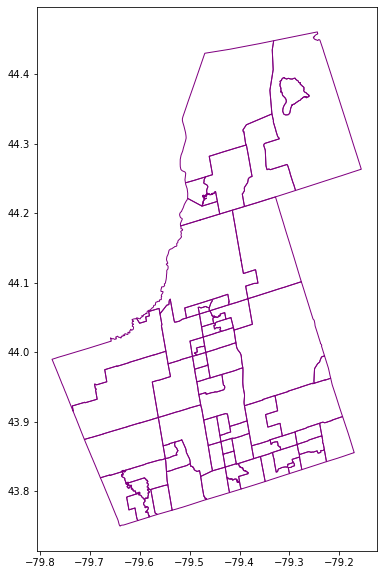

In [7]:
shapefile_york.plot(figsize=(20,10), edgecolor="purple", facecolor="None")

In [8]:
gta_latitude = 43.8561
gta_longitude = -79.3370

gta_map = f.Map(location=[gta_latitude, gta_longitude], zoom_start = 9)
gta_map.choropleth(geo_data = shapefile_toronto,
                     fill_color='YlOrRd', 
                     fill_opacity=0.7,
                     line_opacity=0.2,
                     reset = True
                     )
gta_map.choropleth(geo_data = shapefile_york,
                     fill_color='YlOrRd', 
                     fill_opacity=0.7,
                     line_opacity=0.2,
                     reset = True
                     )
gta_map.choropleth(geo_data = shapefile_durham,
                     fill_color='YlOrRd', 
                     fill_opacity=0.7,
                     line_opacity=0.2,
                     reset = True
                     )
gta_map.choropleth(geo_data = shapefile_oakville,
                     fill_color='YlOrRd', 
                     fill_opacity=0.7,
                     line_opacity=0.2,
                     reset = True
                     )
gta_map.choropleth(geo_data = shapefile_burlington,
                     fill_color='YlOrRd', 
                     fill_opacity=0.7,
                     line_opacity=0.2,
                     reset = True
                     )
gta_map.choropleth(geo_data = shapefile_peel,
                     fill_color='YlOrRd', 
                     fill_opacity=0.7,
                     line_opacity=0.2,
                     reset = True
                     )

gta_map

## Housing data for Ontario

In [9]:
import pandas as pd
import numpy as np

In [10]:
df = pd.read_csv('C:/Users/Jonathan.Densil/Documents/Personal/Coding/IBM Data Science Course/Course 9/ibm-data-science-capstone-project/Capstone Project/Data/properties.csv')
df.head()

,Unnamed: 0,Address,AreaName,Price ($),lat,lng
0,0,"86 Waterford Dr Toronto, ON",Richview,999888,43.679882,-79.544266
1,1,"#80 - 100 BEDDOE DR Hamilton, ON",Chedoke Park B,399900,43.250000,-79.904396
2,2,"213 Bowman Street Hamilton, ON",Ainslie Wood East,479000,43.251690,-79.919357
3,3,"102 NEIL Avenue Hamilton, ON",Greenford,285900,43.227161,-79.767403
4,6,"#1409 - 230 King St Toronto, ON",Downtown,362000,43.651478,-79.368118


In [11]:
df.drop(columns = 'Unnamed: 0', axis = 1, inplace = True)

In [12]:
df

,Address,AreaName,Price ($),lat,lng
0,"86 Waterford Dr Toronto, ON",Richview,999888,43.679882,-79.544266
1,"#80 - 100 BEDDOE DR Hamilton, ON",Chedoke Park B,399900,43.250000,-79.904396
2,"213 Bowman Street Hamilton, ON",Ainslie Wood East,479000,43.251690,-79.919357
3,"102 NEIL Avenue Hamilton, ON",Greenford,285900,43.227161,-79.767403
4,"#1409 - 230 King St Toronto, ON",Downtown,362000,43.651478,-79.368118
...,...,...,...,...,...
25346,"3100 CARLING AVENUE UNIT#416 Ottawa, ON",Bayshore,154900,45.353519,-75.807793
25347,"5827 GLADEWOODS PLACE Ottawa, ON",Orléans,624900,45.441273,-75.532745
25348,"6349 DEERMEADOW DRIVE Ottawa, ON",Greely,899000,45.238155,-75.602249
25349,"212 ALVIN ROAD Ottawa, ON",Rockcliffe - Manor Park,295000,45.453838,-75.650040


In [13]:
is_NaN = df.isnull()
row_has_NaN = is_NaN.any(axis=1)
rows_with_NaN = df[row_has_NaN]
rows_with_NaN

,Address,AreaName,Price ($),lat,lng
209,"7393 Wellington Rd 51 . Ariss, ON",NaN,699000,43.596718,-80.340660
1022,"120 WOODBURN Road Glanbrook, ON",NaN,329900,-999.000000,-999.000000
1132,"457289 CONCESSION 8 S Sydenham Twp, ON",NaN,729900,-999.000000,-999.000000
1186,"152 MARR Drive Elora, ON",NaN,399900,43.693314,-80.437492
1192,"3058 Bruce Road 20 Other Bruce Township, ON",NaN,189900,-999.000000,-999.000000
...,...,...,...,...,...
24558,"823 English Settlement Rd Murray Ward, ON",NaN,699000,-999.000000,-999.000000
24586,"3606 CEDAR GROVE ROAD Prescott, ON",NaN,399999,44.743317,-75.517426
25095,"7256 Wellington Road 124 Road Guelph, ON",NaN,499900,43.494778,-80.285805
25099,"7985 Tait`s Beach Rd Hamilton Township, ON",NaN,599000,44.109016,-78.273743


In [14]:
df[df.eq(-999.000000).any(1)]

,Address,AreaName,Price ($),lat,lng
1022,"120 WOODBURN Road Glanbrook, ON",NaN,329900,-999.0,-999.0
1132,"457289 CONCESSION 8 S Sydenham Twp, ON",NaN,729900,-999.0,-999.0
1192,"3058 Bruce Road 20 Other Bruce Township, ON",NaN,189900,-999.0,-999.0
2836,"552 SULLIVAN STREET UNKN, ON",NaN,119900,-999.0,-999.0
2863,"4575 Bruce Road 1 Municipality Of Brockton, ON",NaN,850000,-999.0,-999.0
...,...,...,...,...,...
23844,"N/A LUPTON CRT N/A LUPTON CRT EMILY, ON",NaN,99800,-999.0,-999.0
23895,"2540 OLD FORT RD Tay Township, ON",NaN,189900,-999.0,-999.0
23973,"3199 MATAWATCHAN ROAD UNKN, ON",NaN,74900,-999.0,-999.0
24171,"Part 2 Jones Rd Hastings, ON",NaN,149900,-999.0,-999.0


In [15]:
df.drop(df.loc[df['lat']==-999.000000].index, inplace = True)
df.reset_index(inplace = True)
df.drop(columns = 'index', inplace = True)
df.head()

,Address,AreaName,Price ($),lat,lng
0,"86 Waterford Dr Toronto, ON",Richview,999888,43.679882,-79.544266
1,"#80 - 100 BEDDOE DR Hamilton, ON",Chedoke Park B,399900,43.250000,-79.904396
2,"213 Bowman Street Hamilton, ON",Ainslie Wood East,479000,43.251690,-79.919357
3,"102 NEIL Avenue Hamilton, ON",Greenford,285900,43.227161,-79.767403
4,"#1409 - 230 King St Toronto, ON",Downtown,362000,43.651478,-79.368118


In [21]:
gta_latitude = 43.8561
gta_longitude = -79.3370

houses_map = f.Map(location=[gta_latitude, gta_longitude], zoom_start = 5)
f.TileLayer('CartoDB dark_matter').add_to(houses_map) # Sets Tile Theme to (Dark Theme)

# add markers to map
for lat, lng in zip(df['lat'], df['lng']):
        f.CircleMarker(
        [lat, lng],
        radius=5,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(houses_map)  
    
houses_map

In [17]:
# Drop loactions that are outside the GTA

min_lat = 43.286446
min_lng = -80.144595
max_lat = 44.517924
max_lng = -78.435489

In [18]:
df_gta = df.loc[(df['lat'] >= min_lat) & (df['lat'] <= max_lat) & (df['lng'] >= min_lng) & (df['lng'] <= max_lng)].copy()
df_gta.reset_index(inplace = True)
df_gta.drop(columns = 'index', axis = 1, inplace = True)
df_gta.head()

,Address,AreaName,Price ($),lat,lng
0,"86 Waterford Dr Toronto, ON",Richview,999888,43.679882,-79.544266
1,"#1409 - 230 King St Toronto, ON",Downtown,362000,43.651478,-79.368118
2,"254A Monarch Park Ave Toronto, ON",Old East York,1488000,43.686375,-79.328918
3,"532 Caledonia Rd Toronto, ON",Fairbank,25,43.691193,-79.461662
4,"1170 LAMBTON Drive Oakville, ON",Clearview,1289000,43.495579,-79.658272


In [19]:
gta_latitude = 43.8561
gta_longitude = -79.3370

gta_houses_map = f.Map(location=[gta_latitude, gta_longitude], zoom_start = 9)
f.TileLayer('CartoDB dark_matter').add_to(gta_houses_map) # Sets Tile Theme to (Dark Theme)

# add markers to map
for lat, lng in zip(df_gta['lat'], df_gta['lng']):
        f.CircleMarker(
        [lat, lng],
        radius=5,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(gta_houses_map)  
    
gta_houses_map